# Team Cosmos
# Team ID : T-0821990

Importing Necessary Libraries

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

Read dataset

In [ ]:
dataset = pd.read_csv('dataset.csv')

# 1.Exploratory Data Analysis(EDA)

In [ ]:
dataset.head()

,Name,Epoch Date Close Approach,Relative Velocity km per sec,Relative Velocity km per hr,Miles per hour,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Miss Dist.(miles),Jupiter Tisserand Invariant,...,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,approach_year,approach_month,approach_day,Orbital Period,Orbit Uncertainity,Hazardous
0,3703080,7.889472e+11,Very Slow,22017.003799,13680.509944,0.419483,163.178711,62753692.0,38993336.0,NaN,...,2.005764,NaN,264.837533,0.590551,NaN,1.0,1.0,Low,Medium,True
1,3723955,NaN,Slow,65210.346095,40519.173105,NaN,NaN,57298148.0,35603420.0,NaN,...,1.497352,2.457795e+06,173.741112,0.845330,1995.0,1.0,1.0,Low,NaN,False
2,2446862,7.895520e+11,NaN,27326.560182,16979.661798,0.050956,19.821890,7622911.5,4736657.5,4.557,...,1.966857,2.458120e+06,NaN,NaN,1995.0,NaN,8.0,Medium,NaN,True
3,3092506,7.901568e+11,Very Slow,40225.948191,24994.839864,NaN,NaN,NaN,26522368.0,5.093,...,1.527904,2.457902e+06,68.741007,0.700277,1995.0,NaN,15.0,Low,Medium,False
4,3514799,7.901568e+11,Very Slow,35426.991794,NaN,0.407832,158.646713,61010824.0,NaN,5.154,...,NaN,2.457814e+06,NaN,NaN,NaN,NaN,15.0,NaN,Low,True


**1.1 Data Inspection**

In [ ]:
dataset.columns

Index(['Name', 'Epoch Date Close Approach', 'Relative Velocity km per sec',
       'Relative Velocity km per hr', 'Miles per hour',
       'Miss Dist.(Astronomical)', 'Miss Dist.(lunar)',
       'Miss Dist.(kilometers)', 'Miss Dist.(miles)',
       'Jupiter Tisserand Invariant', 'Epoch Osculation', 'Semi Major Axis',
       'Asc Node Longitude', 'Perihelion Arg', 'Aphelion Dist',
       'Perihelion Time', 'Mean Anomaly', 'Mean Motion', 'approach_year',
       'approach_month', 'approach_day', 'Orbital Period',
       'Orbit Uncertainity', 'Hazardous'],
      dtype='object')

In [ ]:
dataset.dtypes

,0
Name,int64
Epoch Date Close Approach,float64
Relative Velocity km per sec,object
Relative Velocity km per hr,float64
Miles per hour,float64
Miss Dist.(Astronomical),float64
Miss Dist.(lunar),float64
Miss Dist.(kilometers),float64
Miss Dist.(miles),float64
Jupiter Tisserand Invariant,float64


In [ ]:
statistics = dataset.describe()
statistics.loc['range'] = statistics.loc['max']-statistics.loc['min']
statistics

,Name,Epoch Date Close Approach,Relative Velocity km per hr,Miles per hour,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Miss Dist.(miles),Jupiter Tisserand Invariant,Epoch Osculation,Semi Major Axis,Asc Node Longitude,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,approach_year,approach_month,approach_day
count,4.534000e+03,3.280000e+03,3033.000000,3668.000000,3933.000000,3417.000000,3.166000e+03,3.882000e+03,2802.000000,3.007000e+03,3346.000000,3438.000000,3400.000000,3719.000000,2.970000e+03,3616.000000,3026.000000,3715.000000,3006.000000,3991.000000
mean,3.268624e+06,1.178921e+12,50516.969113,31312.455735,0.258221,100.709883,3.842441e+07,2.391178e+07,5.126265,2.457720e+06,1.358242,172.185790,185.148924,1.898115,2.457741e+06,182.735237,0.761090,2006.920592,6.474385,14.896517
std,5.517954e+05,1.986535e+11,26530.144294,16386.183907,0.146070,56.938739,2.207442e+07,1.357595e+07,1.197144,9.248399e+02,0.465313,103.055919,103.417240,0.834499,9.155433e+02,107.757042,0.337745,6.292621,3.462926,5.717762
min,2.000433e+06,7.889472e+11,1207.814804,750.489149,0.000178,0.187669,2.660989e+04,1.653462e+04,2.367000,2.450936e+06,0.615920,0.001941,0.006918,0.803765,2.450100e+06,0.003191,0.239363,1995.000000,1.000000,1.000000
25%,3.092344e+06,1.014365e+12,30437.415189,18843.393552,0.135807,52.877514,1.950318e+07,1.246634e+07,4.179250,2.458000e+06,0.990008,83.288427,96.100513,1.260397,2.457826e+06,87.066671,0.483841,2002.000000,3.000000,8.000000
50%,3.513224e+06,1.202458e+12,46968.245275,28959.416222,0.265281,104.261452,3.987901e+07,2.476464e+07,5.102500,2.458000e+06,1.223551,173.895246,192.420121,1.590005,2.457976e+06,189.051112,0.737684,2008.000000,7.000000,15.000000
75%,3.691155e+06,1.354954e+12,65210.346095,40331.941346,0.387033,150.434433,5.769962e+07,3.581782e+07,6.043000,2.458000e+06,1.626350,253.635285,273.067950,2.331365,2.458109e+06,278.038676,1.002870,2013.000000,10.000000,22.000000
max,3.781897e+06,1.473318e+12,160681.487851,99841.227826,0.499884,194.359650,7.478160e+07,4.646713e+07,9.025000,2.458000e+06,2.568553,359.905890,359.993098,4.662158,2.458706e+06,359.917991,1.946801,2016.000000,12.000000,22.000000
range,1.781464e+06,6.843708e+11,159473.673047,99090.738678,0.499706,194.171981,7.475499e+07,4.645060e+07,6.658000,7.064000e+03,1.952633,359.903949,359.986180,3.858393,8.605420e+03,359.914799,1.707437,21.000000,11.000000,21.000000


In [ ]:
dataset.isnull().sum()

,0
Name,0
Epoch Date Close Approach,1254
Relative Velocity km per sec,1350
Relative Velocity km per hr,1501
Miles per hour,866
Miss Dist.(Astronomical),601
Miss Dist.(lunar),1117
Miss Dist.(kilometers),1368
Miss Dist.(miles),652
Jupiter Tisserand Invariant,1732


In [ ]:
Actual_data = dataset.copy()

In [ ]:
categorical_features = dataset.select_dtypes(include=['object']).columns
numerical_features = dataset.select_dtypes(include=['int64','float64']).columns

In [ ]:
numerical_features

Index(['Name', 'Epoch Date Close Approach', 'Relative Velocity km per hr',
       'Miles per hour', 'Miss Dist.(Astronomical)', 'Miss Dist.(lunar)',
       'Miss Dist.(kilometers)', 'Miss Dist.(miles)',
       'Jupiter Tisserand Invariant', 'Epoch Osculation', 'Semi Major Axis',
       'Asc Node Longitude', 'Perihelion Arg', 'Aphelion Dist',
       'Perihelion Time', 'Mean Anomaly', 'Mean Motion', 'approach_year',
       'approach_month', 'approach_day'],
      dtype='object')

In [ ]:
categorical_features

Index(['Relative Velocity km per sec', 'Orbital Period', 'Orbit Uncertainity'], dtype='object')

In [ ]:
for col in numerical_features:
  dataset[col].fillna(dataset[col].median(), inplace=True)

In [ ]:
for col in categorical_features:
  dataset[col].fillna(dataset[col].mode()[0], inplace=True)

In [ ]:
dataset.isnull().sum()
# sns.heatmap(dataset.isnull(),yticklabels=False,cbar=False,cmap="viridis")

,0
Name,0
Epoch Date Close Approach,0
Relative Velocity km per sec,0
Relative Velocity km per hr,0
Miles per hour,0
Miss Dist.(Astronomical),0
Miss Dist.(lunar),0
Miss Dist.(kilometers),0
Miss Dist.(miles),0
Jupiter Tisserand Invariant,0


**1.2 Statistical Inference**

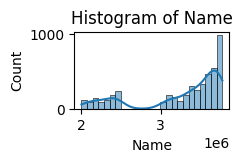

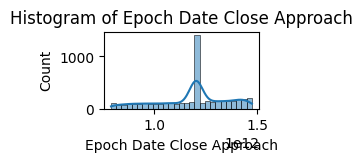

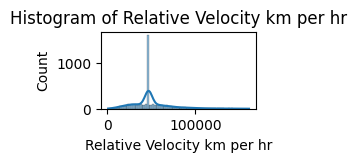

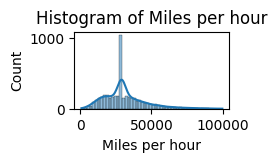

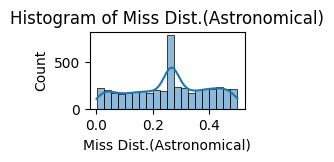

...

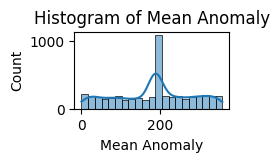

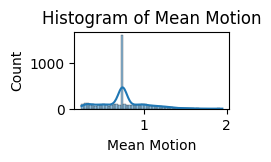

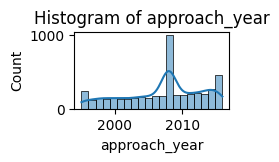

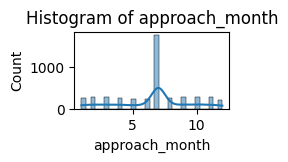

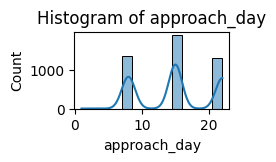

In [ ]:
for col in numerical_features:
  plt.figure(figsize=(2, 1))
  sns.histplot(dataset[col], kde=True)
  plt.title(f'Histogram of {col}')
  plt.show()
  print('\n')

In [ ]:
# checking for skewness
for col in numerical_features:
    skewness = dataset[col].skew()
    print(f"Skewness of {col}: {skewness}")

Skewness of Name: -1.0838821547073445
Skewness of Epoch Date Close Approach: -0.4519105085269471
Skewness of Relative Velocity km per hr: 1.267725543055463
Skewness of Miles per hour: 1.1126427104364272
Skewness of Miss Dist.(Astronomical): -0.12894154764151927
Skewness of Miss Dist.(lunar): -0.18940654595867154
Skewness of Miss Dist.(kilometers): -0.19050084213275756
Skewness of Miss Dist.(miles): -0.14047837638851746
Skewness of Jupiter Tisserand Invariant: 0.25685457136207607
Skewness of Epoch Osculation: -5.0583403766433515
Skewness of Semi Major Axis: 1.2186116352500178
Skewness of Asc Node Longitude: 0.0797889096940696
Skewness of Perihelion Arg: -0.12410292517749404
Skewness of Aphelion Dist: 1.4169605331125532
Skewness of Perihelion Time: -4.897287936808577
Skewness of Mean Anomaly: -0.11488391387554824
Skewness of Mean Motion: 0.5888477990038258
Skewness of approach_year: -0.41996599182247996
Skewness of approach_month: -0.2058998843769639
Skewness of approach_day: 0.016152093

A skewness value greater than 0.5 or less than -0.5 generally indicates that the data is skewed and may need normalization.
we can check values for each

In [ ]:
# standardscalar when there are outliers. minmax scalar when data has known range
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# here there is gaussian distribution so i can use StandardScalar
scaler = StandardScaler()
# applying normalization to numerical features
dataset[numerical_features] = scaler.fit_transform(dataset[numerical_features])

In [ ]:
dataset.head()

,Name,Epoch Date Close Approach,Relative Velocity km per sec,Relative Velocity km per hr,Miles per hour,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Miss Dist.(miles),Jupiter Tisserand Invariant,...,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,approach_year,approach_month,approach_day,Orbital Period,Orbit Uncertainity,Hazardous
0,0.787436,-2.342381,Very Slow,-1.255788,-1.163698,1.178441,1.245671,1.294505,1.190626,-0.015607,...,0.213146,0.205616,0.839707,-0.589488,0.154882,-1.996920,-2.593062,Low,Medium,True
1,0.825271,0.100591,Slow,0.729258,0.653970,0.045012,0.054131,0.998895,0.920812,-0.015607,...,-0.451542,-0.036560,-0.106729,0.333307,-2.121684,-1.996920,-2.593062,Low,Low,False
2,-1.489416,-2.338808,Slow,-1.011775,-0.940261,-1.530337,-1.653570,-1.692764,-1.535969,-0.595303,...,0.162279,0.397867,0.052332,-0.056579,-2.121684,0.123132,-1.288040,Medium,Low,True
3,-0.319208,-2.335235,Very Slow,-0.418955,-0.397427,0.045012,0.054131,0.055037,0.198023,-0.025703,...,-0.411599,0.106739,-1.197616,-0.192066,-2.121684,0.123132,0.016982,Low,Medium,False
4,0.446183,-2.335235,Very Slow,-0.639502,-0.128923,1.092808,1.154016,1.200067,0.058120,0.039121,...,-0.330410,-0.010553,0.052332,-0.056579,0.154882,0.123132,0.016982,Low,Low,True


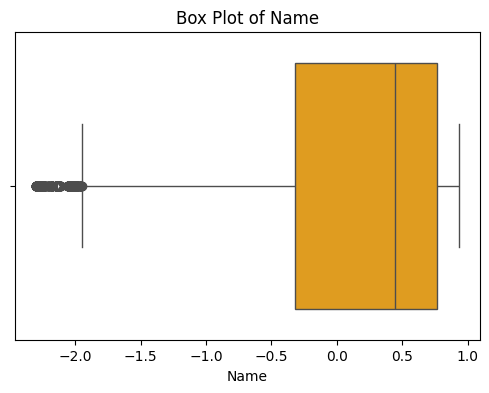

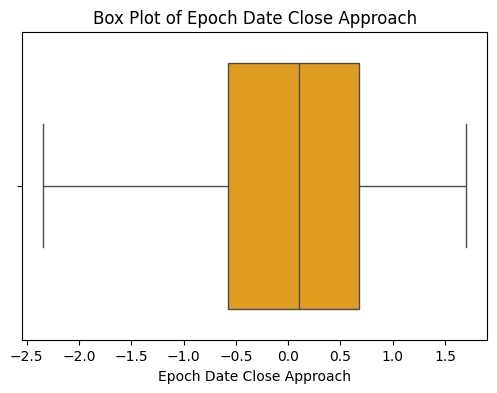

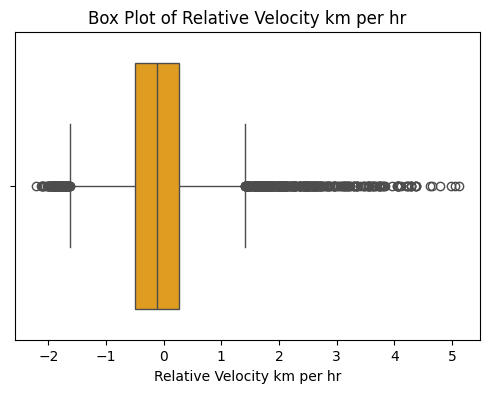

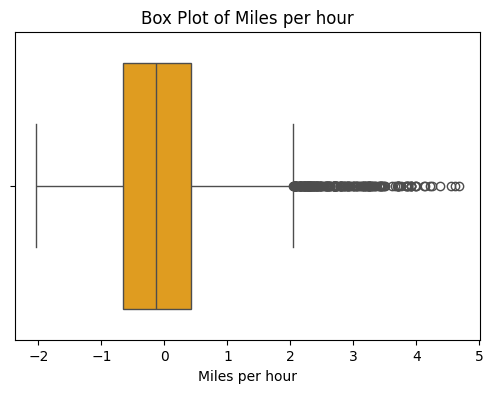

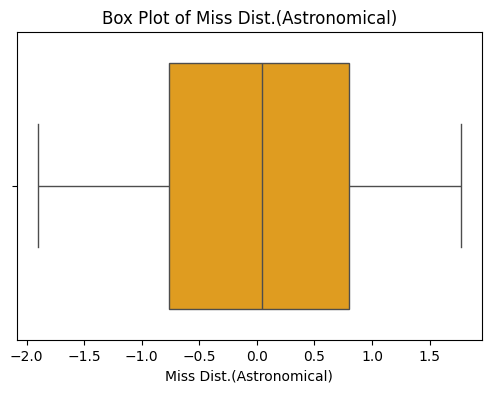

...

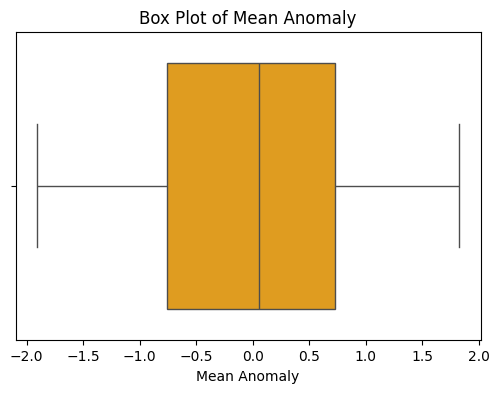

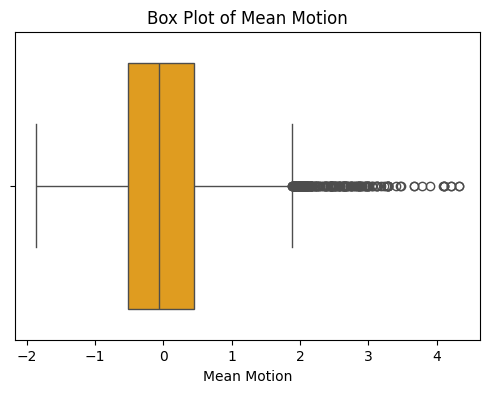

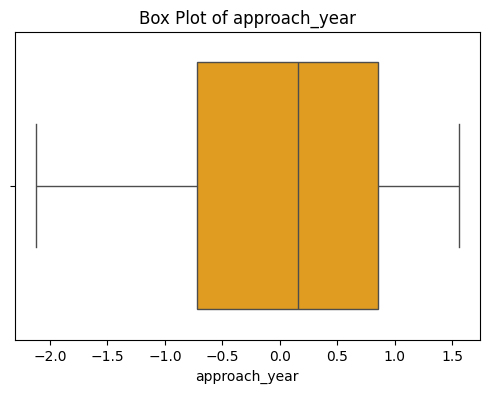

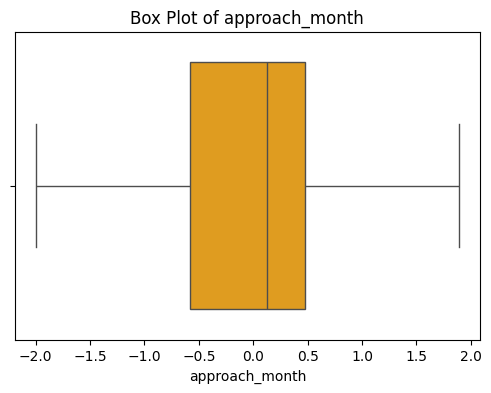

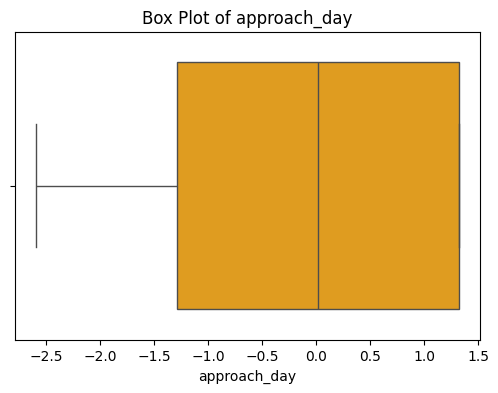

In [ ]:
for col in numerical_features:
    plt.figure(figsize=(6, 4))
    sns.boxplot(x=dataset[col], color='orange')
    plt.title(f'Box Plot of {col}')
    plt.show()

In [ ]:
from scipy import stats

# Identify outliers using z-score
z_scores = stats.zscore(dataset[numerical_features])
abs_z_scores = abs(z_scores)

# Filter rows where z-score is greater than 3
outliers = (abs_z_scores > 3).any(axis=1)

print("Number of outliers detected:", outliers.sum())

Number of outliers detected: 367


Scatter Plots

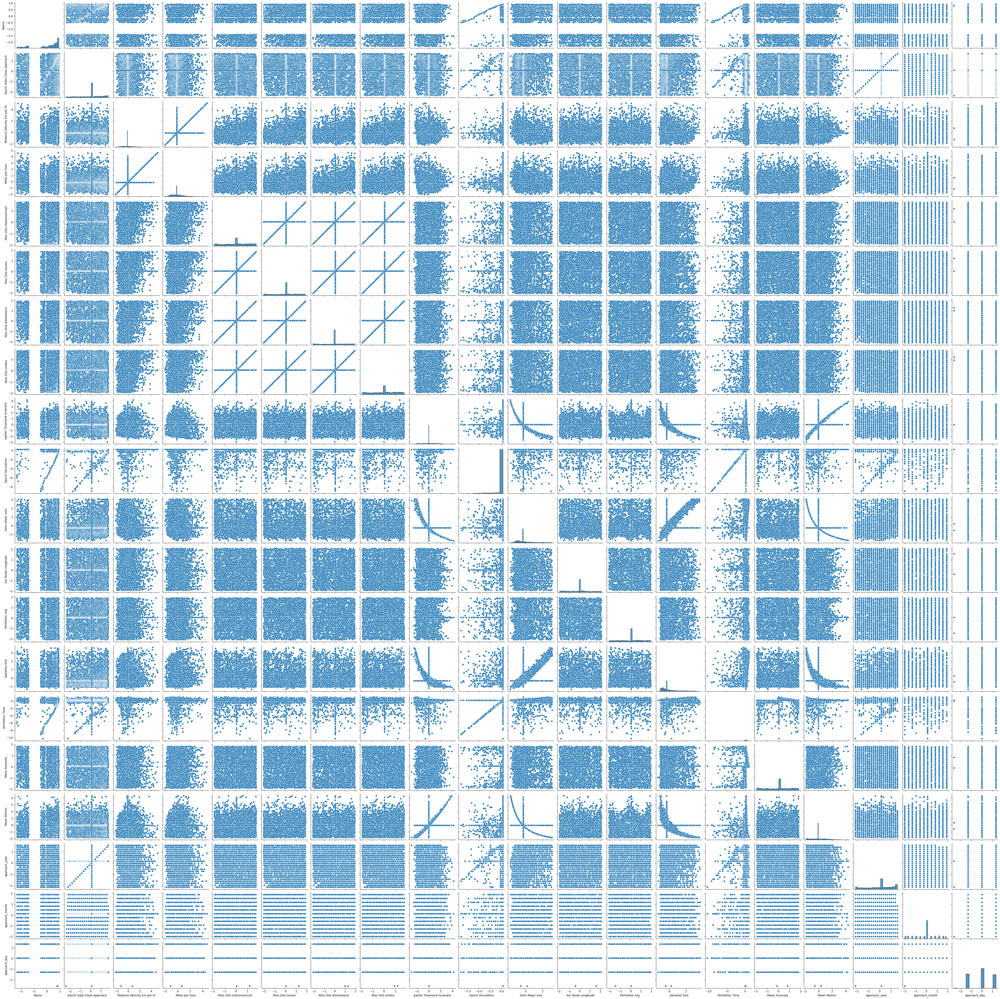

In [ ]:
# Plot scatter plots between pairs of numerical features
sns.pairplot(dataset[numerical_features])
plt.show()

Correlation Matrix

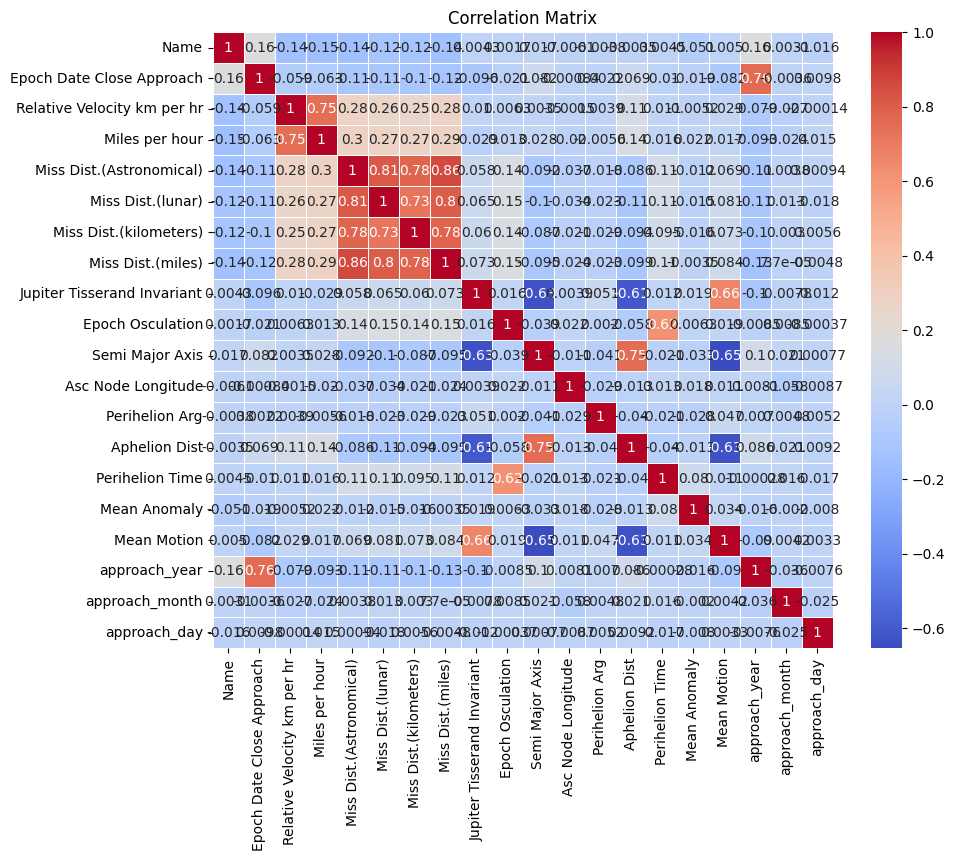

In [ ]:
# Calculate correlation matrix
correlation_matrix = dataset[numerical_features].corr()

# Plot a heatmap of the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

1.3 Visualisation

Creating a pairplot using Seaborn

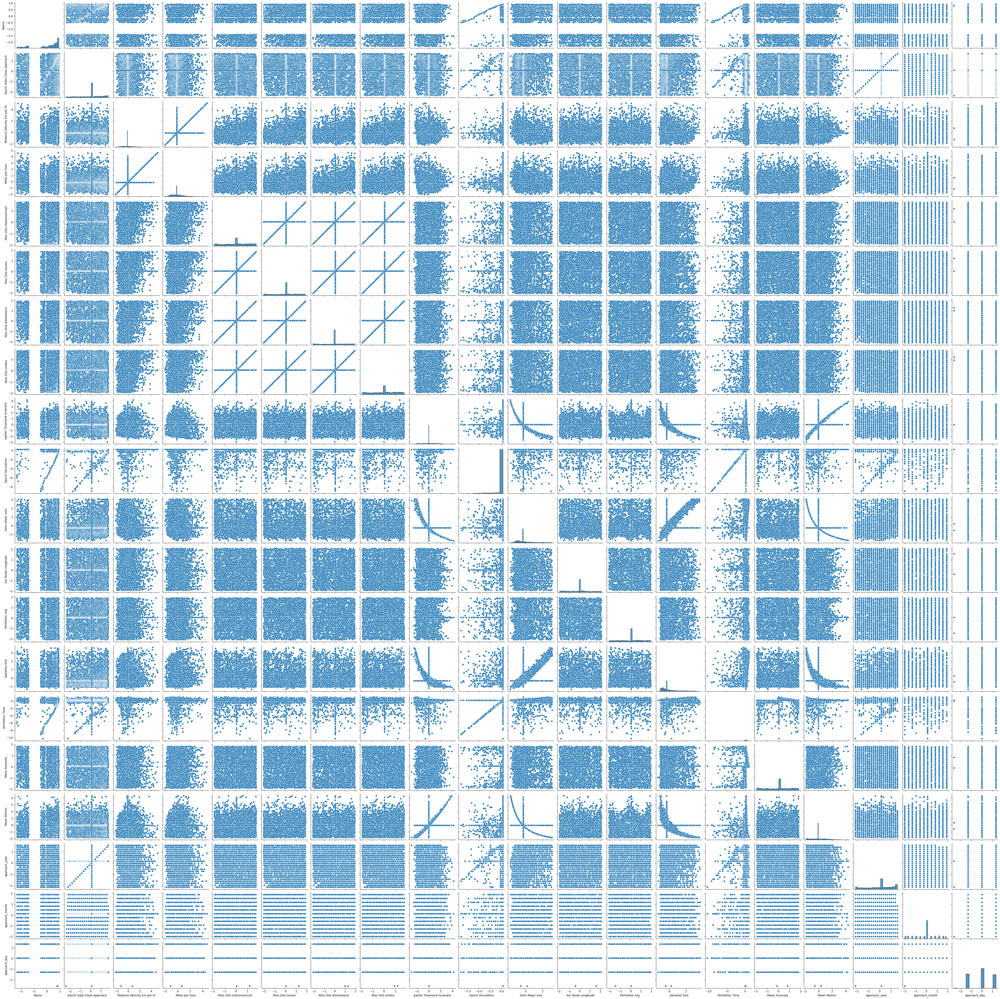

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a pairplot for the numerical features
sns.pairplot(dataset[numerical_features])
plt.show()


 Explanation of the diagonal and off-diagonal plots: Present in the Report

1.4 Tackling Class Imbalance

Class Distribution:
Hazardous
False    3798
True      736
Name: count, dtype: int64


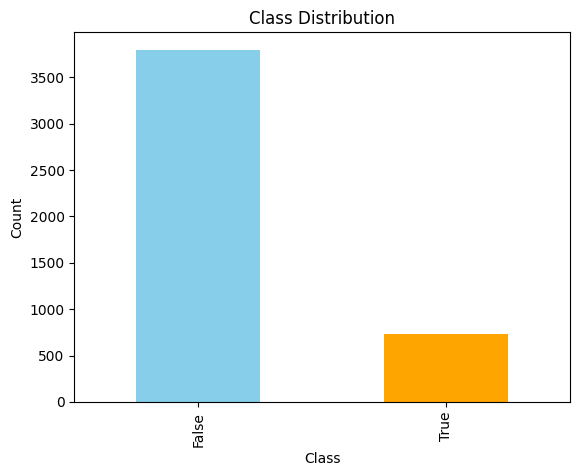

In [ ]:
# Check the distribution of classes in the target column
class_counts = dataset['Hazardous'].value_counts()
print("Class Distribution:")
print(class_counts)

# Plot the distribution of the target column
class_counts.plot(kind='bar', color=['skyblue', 'orange'])
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.show()

Handling Class Imbalance
If a class imbalance exists, you can tackle it with methods such as:

Random Oversampling: Increase the minority class by duplicating examples.
Random Undersampling: Decrease the majority class by removing examples.
SMOTE (Synthetic Minority Oversampling Technique): Create synthetic examples of the minority class.
Class Weighting: Assign higher weights to the minority class in the model to make it more important.


# 2. Numerical Interpretation and Mathematical Analysis

2.1 Feature Engineering

In [ ]:
dataset_formulation = Actual_data[['approach_day','approach_month','approach_year']].copy()
dataset_formulation.head()


,approach_day,approach_month,approach_year
0,1.0,1.0,NaN
1,1.0,1.0,1995.0
2,8.0,NaN,1995.0
3,15.0,NaN,1995.0
4,15.0,NaN,NaN


In [ ]:
dataset_formulation.fillna(method="ffill",inplace=True)
dataset_formulation.fillna(method="bfill",inplace=True)
dataset_formulation.head()

,approach_day,approach_month,approach_year
0,1.0,1.0,1995.0
1,1.0,1.0,1995.0
2,8.0,1.0,1995.0
3,15.0,1.0,1995.0
4,15.0,1.0,1995.0


In [ ]:
dataset_formulation["Date"] = dataset_formulation['approach_month'].astype(int).astype(str)+"-"+dataset_formulation['approach_day'].astype(int).astype(str)+"-"+dataset_formulation['approach_year'].astype(int).astype(str)
dataset_formulation["Date"] = pd.to_datetime(dataset_formulation["Date"])
dataset_formulation.head()

,approach_day,approach_month,approach_year,Date
0,1.0,1.0,1995.0,1995-01-01
1,1.0,1.0,1995.0,1995-01-01
2,8.0,1.0,1995.0,1995-01-08
3,15.0,1.0,1995.0,1995-01-15
4,15.0,1.0,1995.0,1995-01-15


In [ ]:
ratio_1 = dataset["Miss Dist.(kilometers)"]/dataset["Semi Major Axis"]
ratio_1.head()

,0
0,6.221995
1,-1.875634
2,-5.033635
3,-0.223713
4,-4.981407


In [ ]:
# eccentricity , velocity and obital time period
dataset_formulation['eccentricity'] = (dataset["Aphelion Dist"]-dataset["Semi Major Axis"])/dataset["Semi Major Axis"]
dataset_formulation['velocity'] = ((6.6743 * (10**(-11)) )*((1.9891 * (10)**(30)))*((2/dataset["Aphelion Dist"])-(1/dataset["Semi Major Axis"])))**(1/2)
dataset_formulation['orbital_period'] = (2*np.pi)*(((dataset["Semi Major Axis"])**3)/((6.6743 * 10**(-11))*(1.9891 * (10)**(30))))**(1/2)
dataset_formulation.head()

,approach_day,approach_month,approach_year,Date,eccentricity,velocity,orbital_period
0,1.0,1.0,1995.0,1995-01-01,0.024477,2.464971e+10,5.174991e-11
1,1.0,1.0,1995.0,1995-01-01,-0.152136,NaN,NaN
2,8.0,1.0,1995.0,1995-01-08,-0.517443,3.523351e+10,1.063459e-10
3,15.0,1.0,1995.0,1995-01-15,0.673053,NaN,NaN
4,15.0,1.0,1995.0,1995-01-15,0.371512,NaN,NaN


In [ ]:
dataset_formulation['Heliocentric_distance'] = dataset["Semi Major Axis"]*(1+dataset_formulation["eccentricity"])
dataset_formulation['escape_velocity'] = (2*((1.989*(10**30))*(6.6743*(10**(-11)))))/dataset_formulation["Heliocentric_distance"]
dataset_formulation['orbital_energy'] = ((((dataset["Relative Velocity km per hr"]*1000)/3600)**2)/2) - ((((1.989*(10**30))*(6.6743*(10**(-11))))/dataset["Miss Dist.(Astronomical)"]))

In [ ]:
dataset_formulation['Aphelion_velocity']  = ((6.6743 * (10**(-11)) )*((1.9891 * (10)**(30)))*((2/dataset["Aphelion Dist"])-(1/dataset["Semi Major Axis"])))**(1/2)
dataset_formulation['Perihelion_velocity'] = ((6.6743 * (10**(-11)) )*((1.9891 * (10)**(30)))*((2/(dataset["Semi Major Axis"]*(1-dataset_formulation["eccentricity"])))-(1/dataset["Semi Major Axis"])))**(1/2)
dataset_formulation['Synodic_Period'] = 1/((1/dataset_formulation['orbital_period'])-(1/365.25))

# 3. Handling Binned Values

In [ ]:
#Using Ordinal Encoding of features
relative_velocity_mapping = {
    'Very Slow' : 0,
    'Slow' : 1,
    'Fast' : 2,
    'Very Fast' : 3
}
Orbital_Period_mapping = {
    'Low' : 0,
    'Medium' : 1,
    'High' : 2
}
Orbit_Uncert_mapping = {
    'Low' : 0,
    'Medium' : 1,
    'High' : 2
}


dataset['Relative Velocity km per sec Num'] = dataset['Relative Velocity km per sec'].map(relative_velocity_mapping)
dataset['Orbital Period Num'] = dataset['Orbital Period'].map(Orbital_Period_mapping)
dataset['Orbit Uncertainity Num'] = dataset['Orbit Uncertainity'].map(Orbit_Uncert_mapping)


# print(dataset['Relative Velocity km per sec	Num'].value_counts())
print(dataset['Orbital Period Num'].value_counts())
print(dataset['Orbit Uncertainity Num'].value_counts())


Orbital Period Num
0    3135
1     917
2     482
Name: count, dtype: int64
Orbit Uncertainity Num
0    3214
2     671
1     649
Name: count, dtype: int64


In [ ]:
dataset.head()
# dataset['Orbit Uncertainity'].unique()

,Name,Epoch Date Close Approach,Relative Velocity km per sec,Relative Velocity km per hr,Miles per hour,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Miss Dist.(miles),Jupiter Tisserand Invariant,...,Mean Motion,approach_year,approach_month,approach_day,Orbital Period,Orbit Uncertainity,Hazardous,Relative Velocity km per sec Num,Orbital Period Num,Orbit Uncertainity Num
0,0.787436,-2.342381,Very Slow,-1.255788,-1.163698,1.178441,1.245671,1.294505,1.190626,-0.015607,...,-0.589488,0.154882,-1.996920,-2.593062,Low,Medium,True,0,0,1
1,0.825271,0.100591,Slow,0.729258,0.653970,0.045012,0.054131,0.998895,0.920812,-0.015607,...,0.333307,-2.121684,-1.996920,-2.593062,Low,Low,False,1,0,0
2,-1.489416,-2.338808,Slow,-1.011775,-0.940261,-1.530337,-1.653570,-1.692764,-1.535969,-0.595303,...,-0.056579,-2.121684,0.123132,-1.288040,Medium,Low,True,1,1,0
3,-0.319208,-2.335235,Very Slow,-0.418955,-0.397427,0.045012,0.054131,0.055037,0.198023,-0.025703,...,-0.192066,-2.121684,0.123132,0.016982,Low,Medium,False,0,0,1
4,0.446183,-2.335235,Very Slow,-0.639502,-0.128923,1.092808,1.154016,1.200067,0.058120,0.039121,...,-0.056579,0.154882,0.123132,0.016982,Low,Low,True,0,0,0


In [ ]:
final_Data = dataset.drop(['Relative Velocity km per sec','Orbital Period','Orbit Uncertainity'], axis=1)

In [ ]:
final_Data.head()

,Name,Epoch Date Close Approach,Relative Velocity km per hr,Miles per hour,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Miss Dist.(miles),Jupiter Tisserand Invariant,Epoch Osculation,...,Perihelion Time,Mean Anomaly,Mean Motion,approach_year,approach_month,approach_day,Hazardous,Relative Velocity km per sec Num,Orbital Period Num,Orbit Uncertainity Num
0,0.787436,-2.342381,-1.255788,-1.163698,1.178441,1.245671,1.294505,1.190626,-0.015607,0.242927,...,0.205616,0.839707,-0.589488,0.154882,-1.996920,-2.593062,True,0,0,1
1,0.825271,0.100591,0.729258,0.653970,0.045012,0.054131,0.998895,0.920812,-0.015607,0.242927,...,-0.036560,-0.106729,0.333307,-2.121684,-1.996920,-2.593062,False,1,0,0
2,-1.489416,-2.338808,-1.011775,-0.940261,-1.530337,-1.653570,-1.692764,-1.535969,-0.595303,0.242927,...,0.397867,0.052332,-0.056579,-2.121684,0.123132,-1.288040,True,1,1,0
3,-0.319208,-2.335235,-0.418955,-0.397427,0.045012,0.054131,0.055037,0.198023,-0.025703,0.242927,...,0.106739,-1.197616,-0.192066,-2.121684,0.123132,0.016982,False,0,0,1
4,0.446183,-2.335235,-0.639502,-0.128923,1.092808,1.154016,1.200067,0.058120,0.039121,0.242927,...,-0.010553,0.052332,-0.056579,0.154882,0.123132,0.016982,True,0,0,0


# 4. Hazardous Classification

In [ ]:
from sklearn.model_selection import train_test_split, KFold, GridSearchCV
from sklearn.metrics import accuracy_score, roc_curve, auc, confusion_matrix, ConfusionMatrixDisplay
import xgboost as xgb
from sklearn.metrics import roc_auc_score, roc_curve

In [ ]:
from os import X_OK
X = final_Data.drop('Hazardous', axis=1)
y = final_Data['Hazardous']

X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
kf = KFold(n_splits=10, shuffle=True, random_state=42)
accuracy_scores = []
mean_accuracy_scores = []  # Store mean accuracy for each K
loss_scores = []
for k in range(2, 11):  # K values from 2 to 10
    kf = KFold(n_splits=k, shuffle=True, random_state=42)
    xgb_model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')

    for train_idx, val_idx in kf.split(X_train):
        X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
        y_tr, y_val = y_train.iloc[train_idx], y_train.iloc[val_idx]

        xgb_model.fit(X_tr, y_tr)
        y_pred = xgb_model.predict(X_val)

        # Evaluate Accuracy
        accuracy = accuracy_score(y_val, y_pred)
        accuracy_scores.append(accuracy)

    loss_scores.append(1 - np.mean(accuracy))
    mean_accuracy_scores.append(np.mean(accuracy_scores))  # Append mean accuracy for current K
    print(f'For K={k}, Accuracy: {np.mean(accuracy_scores)}')

For K=2, Accuracy: 0.8285090042453407
For K=3, Accuracy: 0.8347948341216267
For K=4, Accuracy: 0.8383749107118873
For K=5, Accuracy: 0.8396773885218713
For K=6, Accuracy: 0.8418683649487262
For K=7, Accuracy: 0.8433365238884505
For K=8, Accuracy: 0.8444838697544732
For K=9, Accuracy: 0.8456713841014463
For K=10, Accuracy: 0.8452514332969637


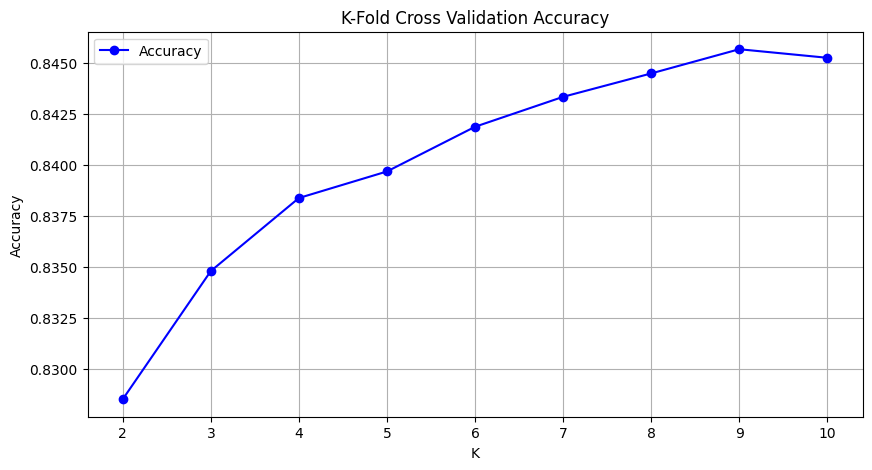

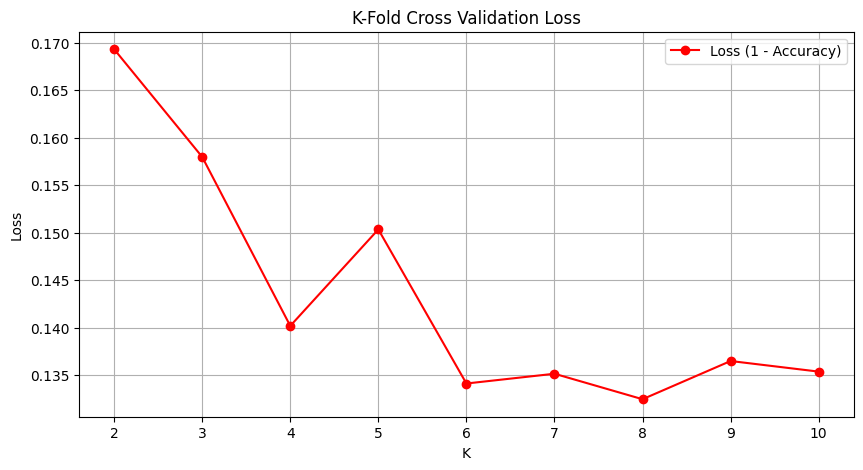

In [ ]:
# Calculate loss as 1 - accuracy for simplicity (since loss is not directly calculated in cross_val_score)
k_values = range(2, 11)


# Plot Accuracy vs K values
plt.figure(figsize=(10, 5))
plt.plot(k_values, mean_accuracy_scores, marker='o', color='b', label='Accuracy')
plt.title('K-Fold Cross Validation Accuracy')
plt.xlabel('K')
plt.ylabel('Accuracy')
plt.grid(True)
plt.legend()
plt.show()

# Plot Loss vs K values
plt.figure(figsize=(10, 5))
plt.plot(k_values, loss_scores, marker='o', color='r', label='Loss (1 - Accuracy)')
plt.title('K-Fold Cross Validation Loss')
plt.xlabel('K')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()
plt.show()

In [ ]:
# Parameter grid for hyperparameter tuning
param_grid = {
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 5, 7],
    'n_estimators': [100, 200, 300],
    'colsample_bytree': [0.7, 0.8, 1.0]
}

# Grid Search with cross-validation
grid_search = GridSearchCV(estimator=xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
                           param_grid=param_grid, cv=7, scoring='accuracy', verbose=1)
grid_search.fit(X_train, y_train)

# Best parameters after optimization
print(f'Best Parameters: {grid_search.best_params_}')


Fitting 9 folds for each of 81 candidates, totalling 729 fits
Best Parameters: {'colsample_bytree': 0.7, 'learning_rate': 0.05, 'max_depth': 7, 'n_estimators': 300}


In [ ]:
# Train with the best parameters
best_params = grid_search.best_params_
xgb_model = xgb.XGBClassifier(**best_params, use_label_encoder=False, eval_metric='logloss')
xgb_model.fit(X_train, y_train)

# Predictions
y_pred = xgb_model.predict(X_valid)
y_pred_proba = xgb_model.predict_proba(X_valid)[:, 1]

In [ ]:
X_train.head()

,Name,Epoch Date Close Approach,Relative Velocity km per hr,Miles per hour,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Miss Dist.(miles),Jupiter Tisserand Invariant,Epoch Osculation,...,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,approach_year,approach_month,approach_day,Relative Velocity km per sec Num,Orbital Period Num,Orbit Uncertainity Num
1874,-1.543158,-0.254165,-0.579054,-0.544026,0.045012,-0.654722,-0.663589,0.058120,-1.186157,0.242927,...,-0.330410,0.193839,-1.763332,-1.155388,0.154882,0.123132,0.016982,0,1,0
1476,-0.174552,0.100591,-0.083077,-0.089869,0.764666,0.802802,0.838189,0.774129,-1.627172,0.242927,...,1.524052,0.501353,1.103565,-1.449043,-0.545600,-1.643578,1.322004,1,1,0
1918,0.120391,0.100591,-0.109098,-0.128923,-0.818574,-0.891761,0.055037,-0.819525,-0.848223,-5.131213,...,0.256052,0.205616,1.781732,-0.961998,-0.195359,-0.230210,0.016982,1,1,2
3344,0.880414,0.100591,0.798382,0.717266,0.045012,0.483540,0.509234,0.473879,1.644841,0.242927,...,-0.867845,0.344231,0.843552,1.575014,0.855363,0.123132,1.322004,1,0,1
3572,-1.410588,1.129109,-0.234536,-0.228558,0.260820,0.054131,0.282543,0.266969,0.056124,0.242927,...,-0.174014,0.221387,-1.817818,-0.056579,1.030484,0.476474,0.016982,1,0,0


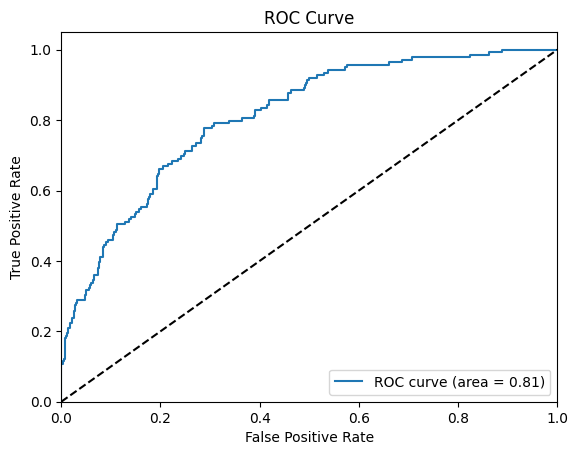

In [ ]:
fpr, tpr, _ = roc_curve(y_valid, y_pred_proba)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()


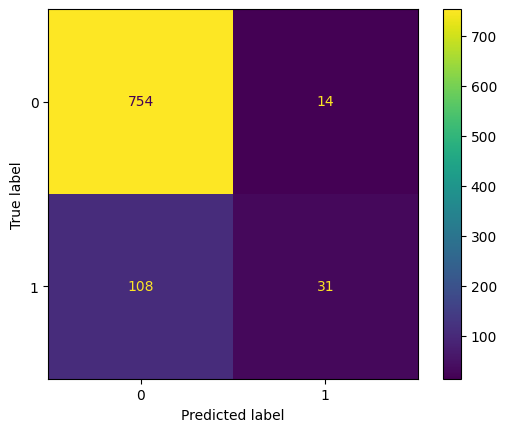

In [ ]:
# Confusion Matrix
cm = confusion_matrix(y_valid, y_pred)
ConfusionMatrixDisplay(cm).plot()
plt.show()

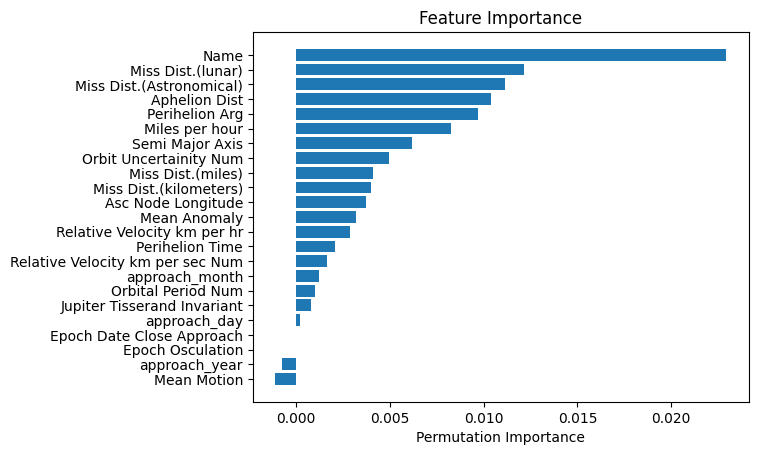

In [ ]:
from sklearn.inspection import permutation_importance

# Compute permutation importance
perm_importance = permutation_importance(xgb_model, X_valid, y_valid, n_repeats=10, random_state=42)

# Get feature importance and sort
sorted_idx = perm_importance.importances_mean.argsort()

# Plot feature importance
plt.barh(X.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel("Permutation Importance")
plt.title("Feature Importance")
plt.show()


# 5. Anomaly Detection

In [ ]:
X_train.head()

,Name,Epoch Date Close Approach,Relative Velocity km per hr,Miles per hour,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Miss Dist.(miles),Jupiter Tisserand Invariant,Epoch Osculation,...,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,approach_year,approach_month,approach_day,Relative Velocity km per sec Num,Orbital Period Num,Orbit Uncertainity Num
1874,-1.543158,-0.254165,-0.579054,-0.544026,0.045012,-0.654722,-0.663589,0.058120,-1.186157,0.242927,...,-0.330410,0.193839,-1.763332,-1.155388,0.154882,0.123132,0.016982,0,1,0
1476,-0.174552,0.100591,-0.083077,-0.089869,0.764666,0.802802,0.838189,0.774129,-1.627172,0.242927,...,1.524052,0.501353,1.103565,-1.449043,-0.545600,-1.643578,1.322004,1,1,0
1918,0.120391,0.100591,-0.109098,-0.128923,-0.818574,-0.891761,0.055037,-0.819525,-0.848223,-5.131213,...,0.256052,0.205616,1.781732,-0.961998,-0.195359,-0.230210,0.016982,1,1,2
3344,0.880414,0.100591,0.798382,0.717266,0.045012,0.483540,0.509234,0.473879,1.644841,0.242927,...,-0.867845,0.344231,0.843552,1.575014,0.855363,0.123132,1.322004,1,0,1
3572,-1.410588,1.129109,-0.234536,-0.228558,0.260820,0.054131,0.282543,0.266969,0.056124,0.242927,...,-0.174014,0.221387,-1.817818,-0.056579,1.030484,0.476474,0.016982,1,0,0


In [ ]:
from sklearn.ensemble import IsolationForest

# Initialize Isolation Forest
iso_forest = IsolationForest(contamination=0.05, random_state=42)  # contamination = expected % of anomalies

# Fit the model to the dataset
iso_forest.fit(X_train)

# Predict anomalies: -1 indicates anomaly, 1 indicates normal
X_train['anomaly_iso_forest'] = iso_forest.predict(X_train)

# Convert -1 to 1 (anomaly) and 1 to 0 (normal)
X_train['anomaly_iso_forest'] = X_train['anomaly_iso_forest'].map({1: 0, -1: 1})

# Print the number of anomalies detected by IsolationForest
iso_forest_anomalies = X_train['anomaly_iso_forest'].sum()
print(f"Number of anomalies detected by IsolationForest: {iso_forest_anomalies}")


Number of anomalies detected by IsolationForest: 182


In [ ]:
import numpy as np

# Custom anomaly detection using Z-score
def detect_anomalies_z_score(data, threshold=3):
    # Calculate Z-scores for each feature
    mean = np.mean(data, axis=0)
    std = np.std(data, axis=0)

    z_scores = (data - mean) / std

    # Flag anomalies where Z-score > threshold (absolute)
    anomalies = np.abs(z_scores) > threshold
    return np.any(anomalies, axis=1).astype(int)  # Return 1 for anomalies, 0 for normal

# Apply Z-score anomaly detection on training data
X_train['anomaly_z_score'] = detect_anomalies_z_score(X_train)

# Print the number of anomalies detected by Z-score method
z_score_anomalies = X_train['anomaly_z_score'].sum()
print(f"Number of anomalies detected by Z-score: {z_score_anomalies}")


Number of anomalies detected by Z-score: 380


Number of examples flagged by both methods: 182


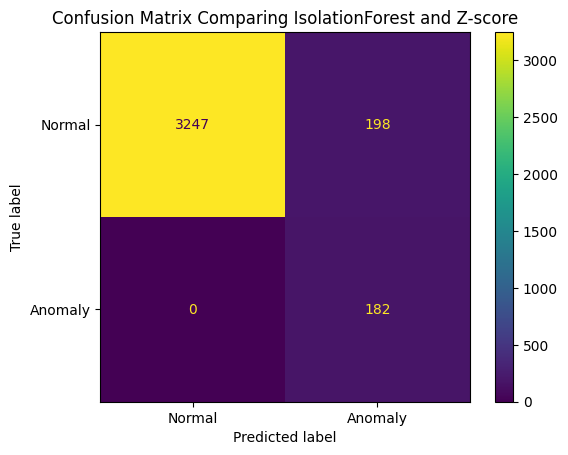

In [ ]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Compare the two methods
X_train['both_flagged'] = ((X_train['anomaly_iso_forest'] == 1) & (X_train['anomaly_z_score'] == 1)).astype(int)

# Print the number of examples flagged by both algorithms
both_flagged_count = X_train['both_flagged'].sum()
print(f"Number of examples flagged by both methods: {both_flagged_count}")

# Plot Confusion Matrix comparing the two methods
cm = confusion_matrix(X_train['anomaly_iso_forest'], X_train['anomaly_z_score'])
ConfusionMatrixDisplay(cm, display_labels=['Normal', 'Anomaly']).plot()
plt.title("Confusion Matrix Comparing IsolationForest and Z-score")
plt.show()
